In [1]:
##### s3에서 밴드 가져와 폴더에 저장 #####

import boto3
from botocore import UNSIGNED
from botocore.config import Config
import os

# ==============================================================================
# [설정] 스크린샷 정보를 바탕으로 작성됨
# ==============================================================================
PUBLIC_BUCKET_NAME = 'sentinel-s2-l2a'

# 스크린샷에 나온 경로 (원하는 날짜/타일이 바뀌면 이 부분만 수정하면 됨)
# 주의: 맨 뒤에 슬래시(/)가 있어야 함
S3_PREFIX = 'tiles/52/S/BE/2025/10/23/0/' 

# SageMaker 내부에 저장할 폴더 위치
LOCAL_DOWNLOAD_DIR = 'sentinel_bands'
os.makedirs(LOCAL_DOWNLOAD_DIR, exist_ok=True)

# 다운로드할 11개 밴드 목록 및 해상도 매핑
# (B01, B02, B03, B04, B05, B06, B07, B08, B8A, B11, B12)
BANDS_INFO = {
    'B01.jp2': 'R60m',
    'B02.jp2': 'R10m',
    'B03.jp2': 'R10m',
    'B04.jp2': 'R10m',
    'B05.jp2': 'R20m',
    'B06.jp2': 'R20m',
    'B07.jp2': 'R20m',
    'B08.jp2': 'R10m',
    'B8A.jp2': 'R20m',
    'B11.jp2': 'R20m',
    'B12.jp2': 'R20m'
}

# ==============================================================================
# [실행 로직] 다운로드 수행
# ==============================================================================
def download_bands_from_public_s3():
    print(f">>> [AWS Public S3] 다운로드 시작...")
    print(f"    버킷: {PUBLIC_BUCKET_NAME}")
    print(f"    경로: {S3_PREFIX}")
    
    # 공개 버킷이므로 인증 없이(UNSIGNED) 접근 설정
    s3 = boto3.client('s3', config=Config(signature_version=UNSIGNED))
    
    success_count = 0
    
    for band_file, res_folder in BANDS_INFO.items():
        # S3 전체 경로 조합: tiles/.../R10m/B02.jp2
        s3_key = f"{S3_PREFIX}{res_folder}/{band_file}"
        local_path = os.path.join(LOCAL_DOWNLOAD_DIR, band_file)
        
        try:
            print(f"    Downloading {band_file} ...", end="")
            s3.download_file(PUBLIC_BUCKET_NAME, s3_key, local_path)
            
            # 파일이 진짜 생겼는지 확인
            if os.path.exists(local_path) and os.path.getsize(local_path) > 0:
                print(" 완료!")
                success_count += 1
            else:
                print(" 실패 (파일 생성 안됨)")
                
        except Exception as e:
            print(f"\n[Error] {band_file} 다운로드 중 오류 발생!")
            print(f"S3 Key 확인용: {s3_key}")
            print(f"에러 메시지: {e}")
            
    print("-" * 50)
    if success_count == 11:
        print(f"✅ 성공! 11개 밴드 파일이 '{LOCAL_DOWNLOAD_DIR}' 폴더에 모두 다운로드되었습니다.")
    else:
        print(f"❌ 경고: {11 - success_count}개 파일 다운로드 실패. 경로를 다시 확인해주세요.")

# 실행
if __name__ == "__main__":
    download_bands_from_public_s3()

>>> [AWS Public S3] 다운로드 시작...
    버킷: sentinel-s2-l2a
    경로: tiles/52/S/BE/2025/10/23/0/
--------------------------------------------------
✅ 성공! 11개 밴드 파일이 'sentinel_bands' 폴더에 모두 다운로드되었습니다.


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 37.6/37.6 MB 47.3 MB/s  0:00:00m0:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.4/16.4 MB 165.9 MB/s  0:00:00
  Attempting uninstall: numpy
    Found existing installation: numpy 1.26.4
    Uninstalling numpy-1.26.4:
      Successfully uninstalled numpy-1.26.4
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4/4 [rasterio]3/4 [rasterio]
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
autogluon-multimodal 1.4.0 requires nvidia-ml-py3<8.0,>=7.352.0, which is not installed.
sagemaker-studio 1.1.4 requires pydynamodb>=0.7.4, which is not installed.
amazon-sagemaker-jupyter-ai-q-developer 1.2.8 requires numpy<=2.0.1, but you have numpy 2.4.1 which is incompatible.
amazon-sagemaker-sql-magic 0.1.4 requires numpy<2, but you have numpy 2.4.1 which is incompatible.
autogluon-common 1.4.0 requires numpy<2.4.0,>=1.25.0, b

Processing Blocks: 100%|██████████| 11/11 [04:42<00:00, 25.71s/it]



🎉 파일 생성 완료: input_stack.tif
📸 미리보기 생성 중...


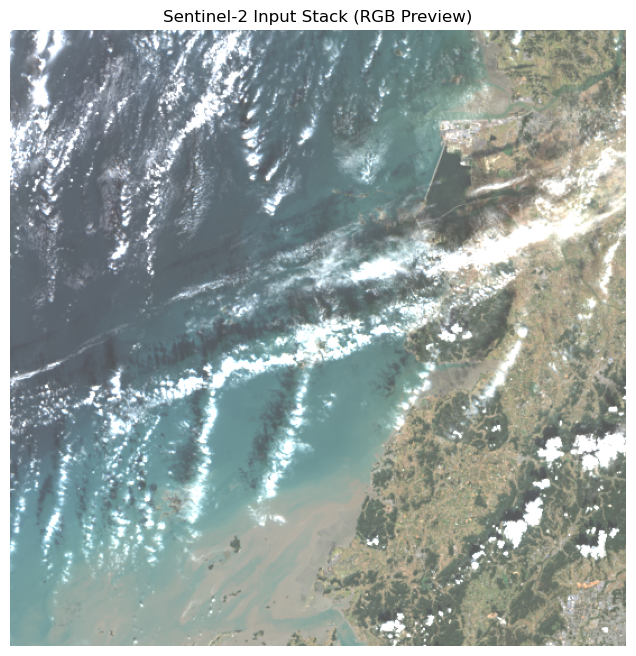

In [2]:
##### 밴드 폴더의 밴드들 합치기 #####

!pip install rasterio
import rasterio
from rasterio.enums import Resampling
from rasterio.windows import Window
import os
import numpy as np
from tqdm import tqdm
import matplotlib.pyplot as plt

# ==============================================================================
# [설정] SageMaker 경로에 맞게 수정됨
# ==============================================================================
# 1. 입력 폴더: 아까 '다운로드 코드'에서 저장한 폴더명 ('sentinel_bands')
INPUT_FOLDER = 'sentinel_bands' 

# 2. 출력 파일: 현재 작업 디렉토리에 저장
OUTPUT_FILENAME = 'input_stack.tif'

TARGET_ORDER = ['B01', 'B02', 'B03', 'B04', 'B05', 'B06', 'B07', 'B08', 'B8A', 'B11', 'B12']
BLOCK_SIZE = 1024 # 처리 덩어리 크기

# ==============================================================================
# [실행 로직]
# ==============================================================================

# 1. 폴더 존재 확인
if not os.path.exists(INPUT_FOLDER):
    print(f"❌ 오류: '{INPUT_FOLDER}' 폴더가 없습니다. 이전 단계(다운로드)를 먼저 실행하세요.")
else:
    print(f"🚀 파일 매핑 시작 (폴더: {INPUT_FOLDER})...")

    all_files = os.listdir(INPUT_FOLDER)
    file_map = {}

    # 파일 찾기 로직 (파일명에 밴드 이름이 포함되어 있는지 확인)
    for fname in all_files:
        full_path = os.path.join(INPUT_FOLDER, fname)
        if os.path.isdir(full_path): continue
        
        # .jp2 파일만 대상
        if not fname.endswith('.jp2'): continue

        for band in TARGET_ORDER:
            # 예: "B01.jp2" 안에 "B01"이 있는지
            if band in fname:
                file_map[band] = full_path
                break
    
    # B08과 B8A 구분 로직 (중복 방지)
    # B8A가 있고 B08 자리에 B8A가 잘못 들어갔다면 수정
    if 'B8A' in file_map and 'B08' in file_map and file_map['B08'] == file_map['B8A']:
        for fname in all_files:
            if 'B08' in fname and 'B8A' not in fname:
                file_map['B08'] = os.path.join(INPUT_FOLDER, fname)
                break

    # 11개 다 찾았는지 확인
    if len(file_map) != 11:
        print(f"❌ 파일 부족! (현재 {len(file_map)}개 발견)")
        print(f"발견된 밴드: {list(file_map.keys())}")
    else:
        print("✅ 11개 밴드 파일 확인 완료.")

        # 기준 정보 읽기 (B02 - 10m 해상도 기준)
        ref_file = file_map['B02']
        with rasterio.open(ref_file) as src:
            ref_meta = src.meta.copy()
            ref_width = src.width
            ref_height = src.height

        # 메타데이터 업데이트 (11채널, Tiled GeoTIFF)
        ref_meta.update(count=11, driver='GTiff', tiled=True, blockxsize=256, blockysize=256)

        print(f"💾 병합 시작... (Target Size: {ref_width}x{ref_height})")

        with rasterio.open(OUTPUT_FILENAME, 'w', **ref_meta) as dst:
            
            # 전체 이미지를 블록 단위로 순회 (메모리 폭발 방지)
            for col_off in tqdm(range(0, ref_width, BLOCK_SIZE), desc="Processing Blocks"):
                for row_off in range(0, ref_height, BLOCK_SIZE):

                    # 현재 윈도우 크기 계산
                    width = min(BLOCK_SIZE, ref_width - col_off)
                    height = min(BLOCK_SIZE, ref_height - row_off)
                    window = Window(col_off, row_off, width, height)

                    # 11개 밴드 순서대로 읽어서 쌓기
                    for i, band_name in enumerate(TARGET_ORDER):
                        p = file_map[band_name]
                        
                        with rasterio.open(p) as src:
                            # 원본에서의 윈도우 위치 계산 (해상도가 다를 수 있으므로 비율 적용)
                            scale_x = src.width / ref_width
                            scale_y = src.height / ref_height

                            src_window = Window(
                                col_off * scale_x,
                                row_off * scale_y,
                                width * scale_x,
                                height * scale_y
                            )

                            # 리사이징이 필요한 경우 (20m, 60m 밴드 -> 10m로)
                            if src.width != ref_width:
                                data = src.read(
                                    1,
                                    window=src_window,
                                    out_shape=(height, width),
                                    resampling=Resampling.bilinear
                                )
                            else:
                                # 해상도 같으면 그냥 읽기
                                data = src.read(1, window=window)

                            # 결과 파일에 쓰기 (Band Index는 1부터 시작)
                            dst.write(data, window=window, indexes=i+1)

        print(f"\n🎉 파일 생성 완료: {OUTPUT_FILENAME}")

        # --- 시각화 (미리보기) ---
        print("📸 미리보기 생성 중...")
        try:
            with rasterio.open(OUTPUT_FILENAME) as src:
                # 썸네일 생성을 위해 1/20 크기로 축소해서 읽기
                overview_factor = 20
                out_shape = (int(src.height / overview_factor), int(src.width / overview_factor))
                
                # RGB (B04, B03, B02) -> Index 4, 3, 2
                r = src.read(4, out_shape=out_shape, resampling=Resampling.bilinear)
                g = src.read(3, out_shape=out_shape, resampling=Resampling.bilinear)
                b = src.read(2, out_shape=out_shape, resampling=Resampling.bilinear)

                rgb = np.dstack((r, g, b))
                # 시각화를 위한 정규화 (Sentinel-2는 보통 3000 정도가 밝은 값)
                rgb_norm = np.clip(rgb / 3000.0, 0, 1)

                plt.figure(figsize=(8, 8))
                plt.imshow(rgb_norm)
                plt.title("Sentinel-2 Input Stack (RGB Preview)")
                plt.axis('off')
                plt.show()
        except Exception as e:
            print(f"⚠️ 시각화 중 오류 발생 (파일은 생성됨): {e}")

In [3]:
##### 모델 로드 #####

import os
import sys
import torch

# ==============================================================================
# [설정] 이미 업로드해둔 파일의 경로를 적어줍니다.
# ==============================================================================
LOCAL_UNET_PATH = '/home/sagemaker-user/unet.py'
LOCAL_MODEL_PATH = '/home/sagemaker-user/model.pth'
# ==============================================================================

def load_local_model():
    print(">>> 로컬 파일에서 모델 로드 시작...")

    # 1. 파일 존재 여부 확인
    if not os.path.exists(LOCAL_UNET_PATH):
        print(f"❌ 실패: {LOCAL_UNET_PATH} 파일을 찾을 수 없습니다.")
        return None, None
    
    if not os.path.exists(LOCAL_MODEL_PATH):
        print(f"❌ 실패: {LOCAL_MODEL_PATH} 파일을 찾을 수 없습니다.")
        return None, None

    # 2. unet.py가 있는 폴더를 시스템 경로에 추가 (import를 위해)
    unet_dir = os.path.dirname(LOCAL_UNET_PATH)
    if unet_dir not in sys.path:
        sys.path.append(unet_dir)
        print(f"    시스템 경로 추가됨: {unet_dir}")

    try:
        # 3. UNet 클래스 가져오기
        from unet import UNet
        
        # 4. 장치 설정
        device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
        print(f"    Device: {device}")

        # 5. 모델 껍데기 생성 (MARIDA 스펙)
        model = UNet(input_bands=11, output_classes=11, hidden_channels=16)
        
        # 6. 가중치(.pth) 로드
        # map_location은 CPU/GPU 상황에 맞게 자동 조절
        state_dict = torch.load(LOCAL_MODEL_PATH, map_location=device)
        model.load_state_dict(state_dict, strict=False)
        
        # 7. 추론 모드 전환 및 GPU로 이동
        model.to(device)
        model.eval()
        
        print(f"✅ 모델 로드 성공!")
        return model, device

    except ImportError:
        print("❌ 에러: unet.py에서 UNet 클래스를 불러올 수 없습니다.")
    except Exception as e:
        print(f"❌ 에러 발생: {e}")
        
    return None, None

# 실행
if __name__ == "__main__":
    model, device = load_local_model()

>>> 로컬 파일에서 모델 로드 시작...
    시스템 경로 추가됨: /home/sagemaker-user
    Device: cpu
✅ 모델 로드 성공!


In [4]:
##### 인풋 밝기 추출 #####

import os
import numpy as np
import rasterio
from tqdm import tqdm

# ==============================================================================
# [설정] MARIDA 모델의 고정된 비밀 키 (Mean, Std)
# ==============================================================================
# (이전 분석에서 확보한 값 - 고정)
MARIDA_MEAN = np.array([0.04484, 0.040945, 0.035334, 0.026897, 0.025076, 0.030968, 0.036087, 0.031758, 0.036754, 0.020314, 0.012555])
MARIDA_STD = np.array([0.007779, 0.009267, 0.010079, 0.010695, 0.010957, 0.018102, 0.022499, 0.021355, 0.024844, 0.014343, 0.008926])

# 내 데이터 경로 (SageMaker 로컬)
INPUT_PATH = './input_stack.tif'

# ==============================================================================
# 1. 내 데이터 통계 추출 (메모리 절약 모드)
# ==============================================================================
def calculate_input_stats():
    print(f">>> '{INPUT_PATH}'의 통계 지문을 추출합니다 (파일 수정 없음)...")
    
    if not os.path.exists(INPUT_PATH):
        print("❌ 오류: input_stack.tif 파일이 없습니다.")
        return None, None

    with rasterio.open(INPUT_PATH) as src:
        band_stats = [[0.0, 0.0, 0] for _ in range(src.count)]
        total_blocks = 0
        for _ in src.block_windows(1): total_blocks += 1
            
        with tqdm(total=total_blocks, desc="Analyzing Stats") as pbar:
            for ji, window in src.block_windows(1):
                data_raw = src.read(window=window) # uint16 읽기
                
                # 통계 계산을 위해 임시로 0~1 변환 (파일 저장 안함)
                data_norm = data_raw.astype(np.float32) / 10000.0
                
                for i in range(src.count):
                    pixels = data_norm[i].flatten()
                    valid_pixels = pixels[pixels > 0]
                    if len(valid_pixels) == 0: continue
                    
                    # Welford 알고리즘
                    for val in valid_pixels:
                        band_stats[i][2] += 1
                        delta = val - band_stats[i][0]
                        band_stats[i][0] += delta / band_stats[i][2]
                        delta2 = val - band_stats[i][0]
                        band_stats[i][1] += delta * delta2
                pbar.update(1)

    my_mean = np.array([s[0] for s in band_stats])
    my_std = np.array([np.sqrt(s[1] / (s[2] - 1)) if s[2] > 1 else 0 for s in band_stats])
    
    return my_mean, my_std

# ==============================================================================
# 2. 비교 및 판단
# ==============================================================================
my_mean, my_std = calculate_input_stats()

if my_mean is not None:
    print("\n" + "="*60)
    print("📊 [MARIDA vs 내 데이터] 통계 지문 비교")
    print("="*60)
    print(f"{'Ch':<4} | {'MARIDA Mean':<12} | {'My Mean':<12} || {'MARIDA Std':<12} | {'My Std':<12}")
    print("-" * 60)
    
    diff_sum = 0
    for i in range(11):
        print(f"{i+1:<4} | {MARIDA_MEAN[i]:.6f}     | {my_mean[i]:.6f}     || {MARIDA_STD[i]:.6f}     | {my_std[i]:.6f}")
        diff_sum += abs(MARIDA_MEAN[i] - my_mean[i])
    
    print("-" * 60)
    print(f">>> 평균 값 차이 합계: {diff_sum:.6f}")
    
    if diff_sum > 0.5: # 임의의 기준값
        print("🚨 [판단] 분포 차이가 큽니다. 추론 시 '표준화(Standardization)'가 필수입니다.")
    else:
        print("✅ [판단] 분포가 유사하지만, 안전을 위해 표준화를 권장합니다.")

>>> './input_stack.tif'의 통계 지문을 추출합니다 (파일 수정 없음)...


Analyzing Stats: 100%|██████████| 1849/1849 [12:43<00:00,  2.42it/s]


📊 [MARIDA vs 내 데이터] 통계 지문 비교
Ch   | MARIDA Mean  | My Mean      || MARIDA Std   | My Std      
------------------------------------------------------------
1    | 0.044840     | 0.211349     || 0.007779     | 0.086010
2    | 0.040945     | 0.215313     || 0.009267     | 0.084528
3    | 0.035334     | 0.207777     || 0.010079     | 0.080637
4    | 0.026897     | 0.192514     || 0.010695     | 0.079899
5    | 0.025076     | 0.203981     || 0.010957     | 0.087265
6    | 0.030968     | 0.216456     || 0.018102     | 0.095014
7    | 0.036087     | 0.224112     || 0.022499     | 0.100242
8    | 0.031758     | 0.232157     || 0.021355     | 0.105778
9    | 0.036754     | 0.229188     || 0.024844     | 0.104400
10   | 0.020314     | 0.210853     || 0.014343     | 0.086375
11   | 0.012555     | 0.191087     || 0.008926     | 0.072724
------------------------------------------------------------
>>> 평균 값 차이 합계: 1.993258
🚨 [판단] 분포 차이가 큽니다. 추론 시 '표준화(Standardization)'가 필수입니다.


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.5/62.5 MB 118.4 MB/s  0:00:00m0:00:0100:01

>>> [UNet 탐지] 좌표 표시 기능 포함 (10980x10980)

--- Patch #1 (위치: 0, 0) ---
   (탐지된 객체 없음)


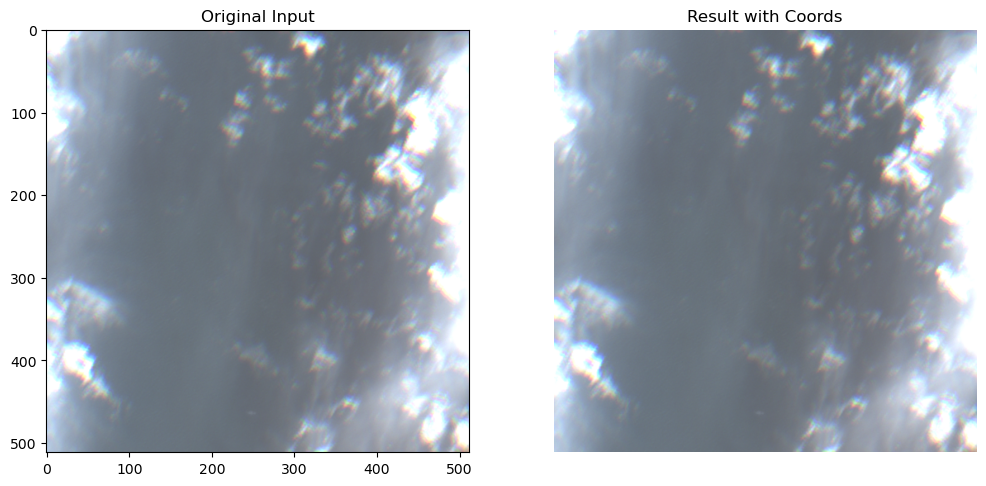


--- Patch #2 (위치: 512, 0) ---
   (탐지된 객체 없음)


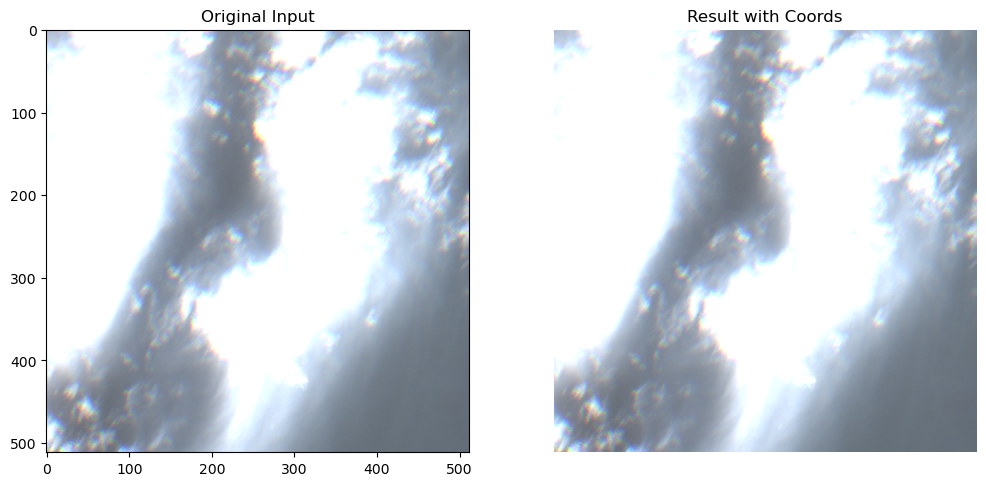


--- Patch #3 (위치: 1024, 0) ---
📍 탐지됨: Ship (총 1개)


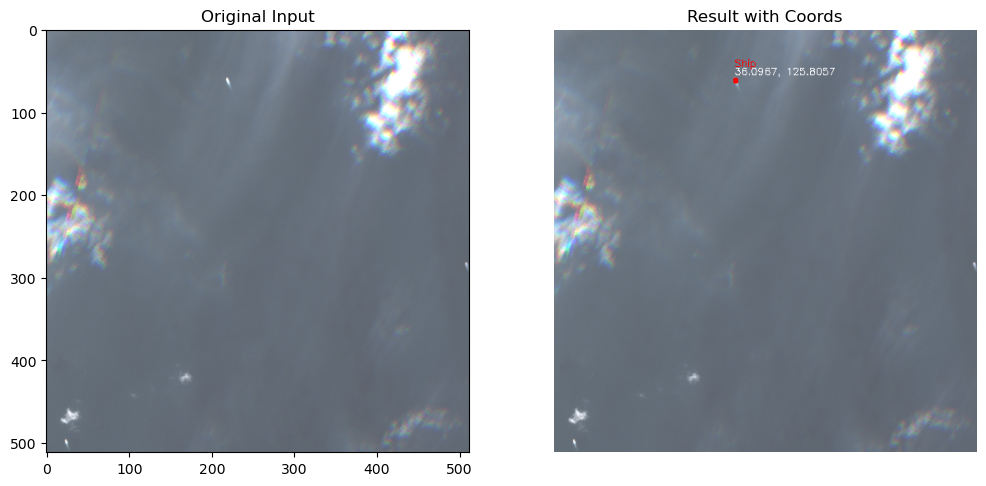


--- Patch #4 (위치: 1536, 0) ---
   (탐지된 객체 없음)


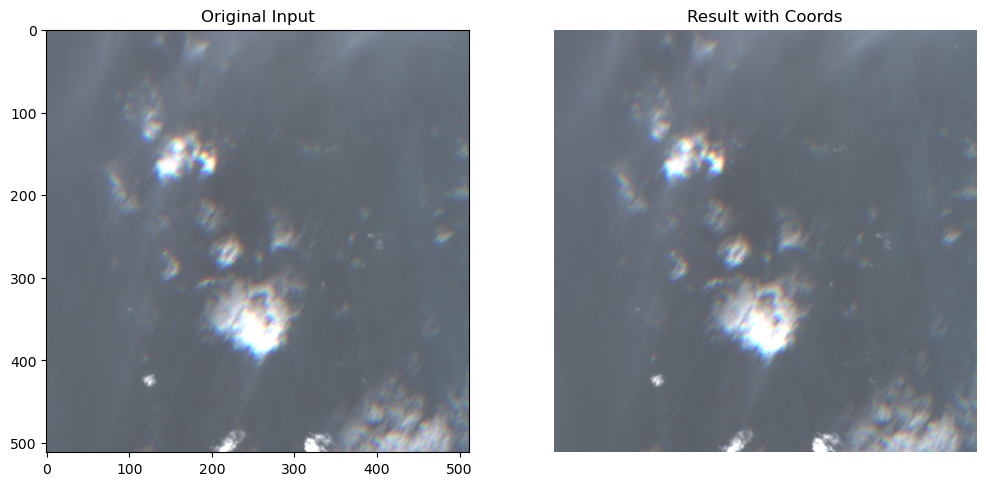


--- Patch #5 (위치: 2048, 0) ---
   (탐지된 객체 없음)


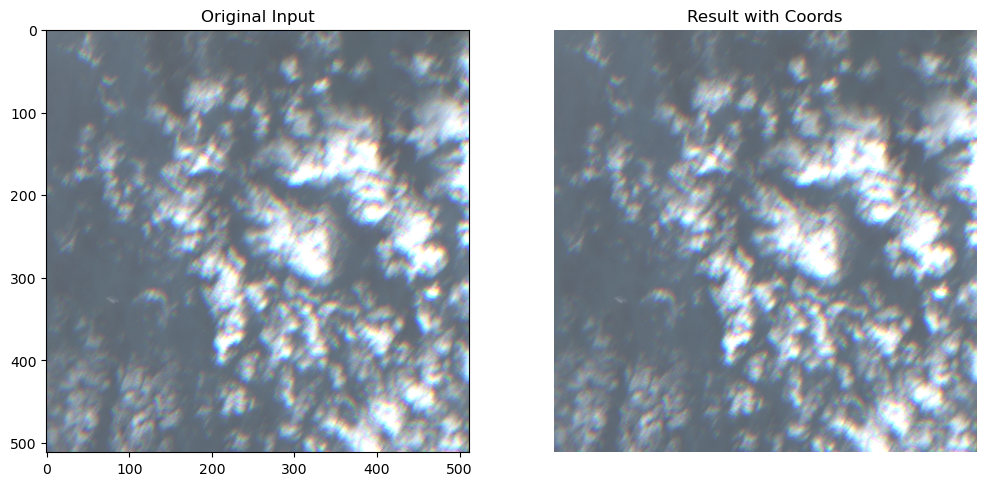


--- Patch #6 (위치: 2560, 0) ---
   (탐지된 객체 없음)


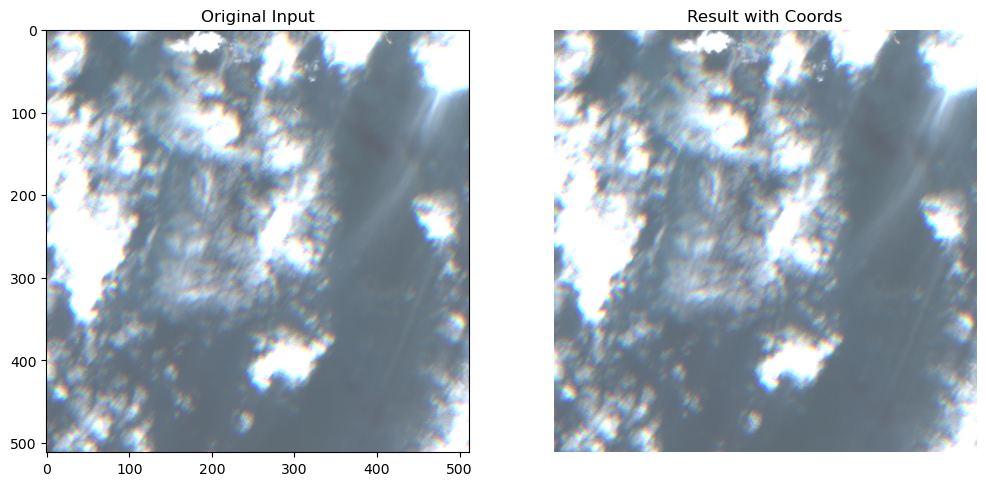


--- Patch #7 (위치: 3072, 0) ---
📍 탐지됨: Ship (총 1개)


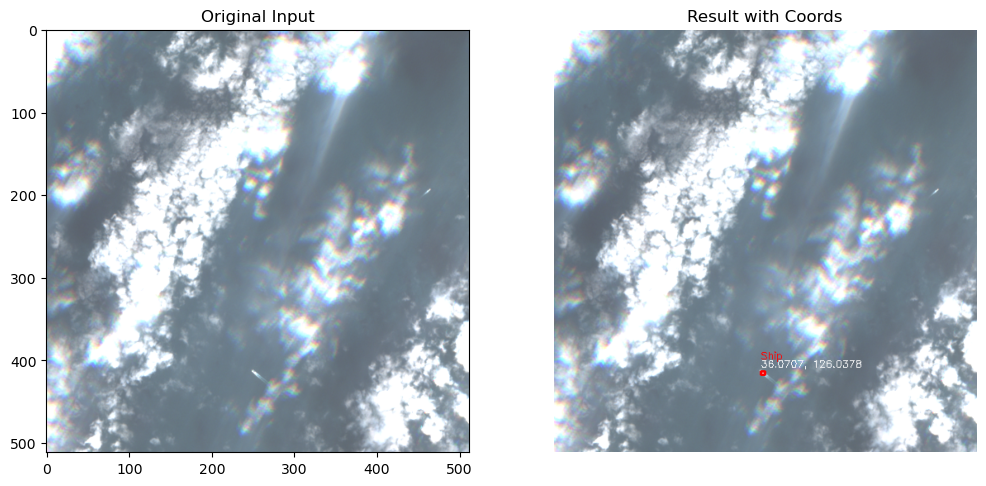


--- Patch #8 (위치: 3584, 0) ---
   (탐지된 객체 없음)


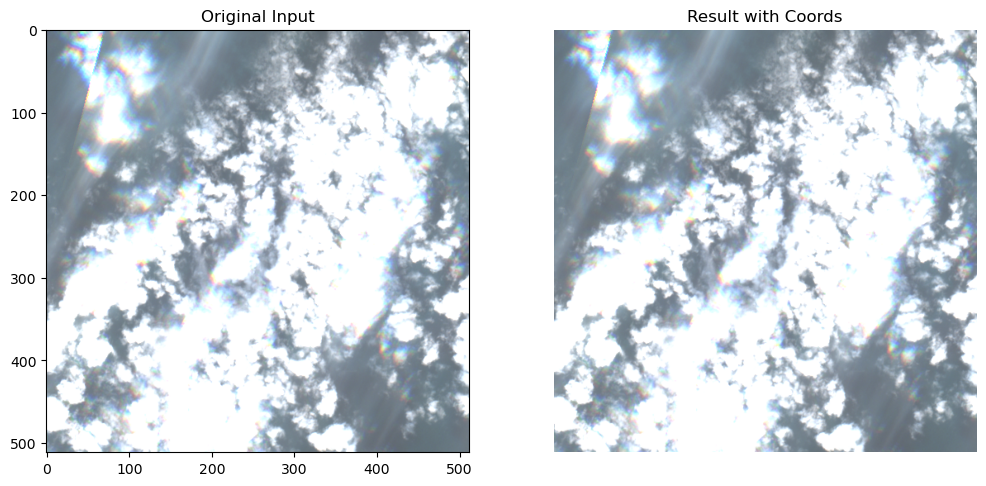


--- Patch #9 (위치: 4096, 0) ---
📍 탐지됨: Ship (총 1개)


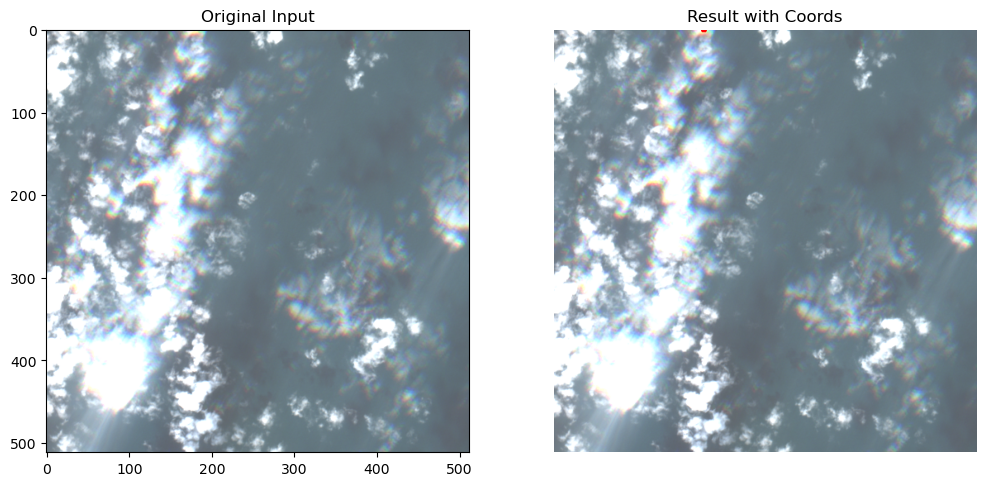


--- Patch #10 (위치: 4608, 0) ---
📍 탐지됨: Ship (총 2개)


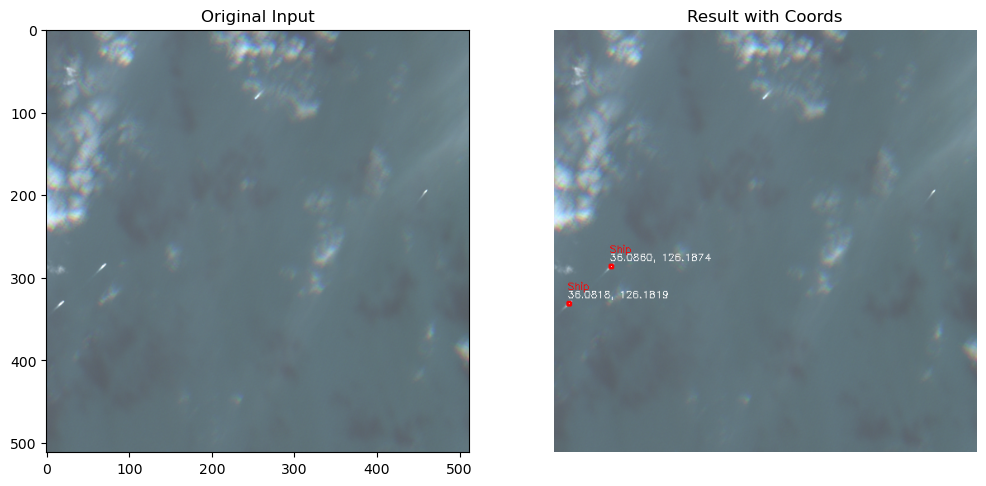


>>> 설정된 조각 개수(10개) 확인 완료.


In [6]:
##### 인풋의 밝기 모델 수준으로 조정 후 추론 ######
!pip install opencv-python-headless
import sys
import os
import torch
import torch.nn.functional as F
import rasterio
import rasterio.warp
import numpy as np
import matplotlib.pyplot as plt
import cv2
from tqdm import tqdm

# --- 설정 ---
INPUT_PATH = './input_stack.tif'
MODEL_PATH = './model.pth'

# 통계 키 (고정)
MARIDA_MEAN = np.array([0.04484, 0.040945, 0.035334, 0.026897, 0.025076, 0.030968, 0.036087, 0.031758, 0.036754, 0.020314, 0.012555])
MARIDA_STD = np.array([0.007779, 0.009267, 0.010079, 0.010695, 0.010957, 0.018102, 0.022499, 0.021355, 0.024844, 0.014343, 0.008926])

# 파라미터
ID_DEBRIS = 0
ID_SHIP = 4
CONF_THRESH = 0.05
MAX_SHOW = 10           # 보여줄 조각 수
MAX_OBJS_PER_PATCH = 10 # 조각당 최대 표시 개수

# --- 모델 로드 ---
sys.path.append('.')
from unet import UNet
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = UNet(input_bands=11, output_classes=11, hidden_channels=16)
state_dict = torch.load(MODEL_PATH, map_location=device)
model.load_state_dict(state_dict, strict=False)
model.to(device)
model.eval()

# --- 유틸리티 ---
def get_lat_lon(global_x, global_y, src):
    try:
        x_crs, y_crs = src.xy(global_y, global_x)
        lon, lat = rasterio.warp.transform(src.crs, {'init': 'epsg:4326'}, [x_crs], [y_crs])
        return lat[0], lon[0]
    except: return 0, 0

def apply_standardization_in_memory(img_raw_11ch, mean_vec, std_vec):
    img_norm = img_raw_11ch.astype(np.float32) / 10000.0
    mean = mean_vec.reshape(-1, 1, 1)
    std = std_vec.reshape(-1, 1, 1)
    return (img_norm - mean) / (std + 1e-8)

# --- 메인 실행 ---
def run_unet_scan_with_coords():
    if not os.path.exists(INPUT_PATH): return

    with rasterio.open(INPUT_PATH) as src:
        h, w = src.height, src.width
        win = 512
        
        print(f"\n>>> [UNet 탐지] 좌표 표시 기능 포함 ({w}x{h})")
        
        patch_count = 0
        
        for y in range(0, h, win):
            for x in range(0, w, win):
                if patch_count >= MAX_SHOW:
                    print(f"\n>>> 설정된 조각 개수({MAX_SHOW}개) 확인 완료.")
                    return
                
                cw, ch = min(win, w - x), min(win, h - y)
                if cw < 64 or ch < 64: continue
                
                patch_count += 1
                
                # 1. 데이터 읽기 & 전처리
                window = rasterio.windows.Window(x, y, cw, ch)
                img_raw = src.read(window=window)
                img_std = apply_standardization_in_memory(img_raw, MARIDA_MEAN, MARIDA_STD)
                
                # 2. 추론
                ph, pw = (32 - ch%32)%32, (32 - cw%32)%32
                img_pad = np.pad(img_std, ((0,0),(0,ph),(0,pw)), 'constant')
                t = torch.from_numpy(img_pad).float().unsqueeze(0).to(device)
                
                with torch.no_grad():
                    out = model(t)
                    probs = F.softmax(out, dim=1).squeeze().cpu().numpy()
                probs = probs[:, :ch, :cw]
                
                # 3. 시각화 준비 (RGB 8bit)
                vis_img = np.clip((img_raw[[3,2,1],:,:].transpose(1,2,0) / 3000.0) * 255, 0, 255).astype(np.uint8)
                res_img = vis_img.copy()
                
                has_obj = False
                found_list = []
                obj_count = 0
                
                # 4. 박스 그리기
                targets = [(ID_SHIP, "Ship", (255,0,0)), (ID_DEBRIS, "Debris", (255,255,0))]
                
                for cid, label, color in targets:
                    mask = (probs[cid] > CONF_THRESH).astype(np.uint8)
                    cnts, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
                    
                    for c in cnts:
                        if cv2.contourArea(c) < 3: continue
                        if obj_count >= MAX_OBJS_PER_PATCH: continue # 개수 제한
                        
                        obj_count += 1
                        has_obj = True
                        
                        bx, by, bw, bh = cv2.boundingRect(c)
                        cv2.rectangle(res_img, (bx, by), (bx+bw, by+bh), color, 2)
                        
                        # 좌표 계산
                        cx, cy = bx + bw//2, by + bh//2
                        lat, lon = get_lat_lon(x + cx, y + cy, src)
                        
                        # 텍스트: 이름 + 좌표
                        lbl = f"{label}"
                        coord_txt = f"{lat:.4f}, {lon:.4f}"
                        
                        # 두 줄로 표시 (가독성 위해)
                        cv2.putText(res_img, lbl, (bx, by-15), cv2.FONT_HERSHEY_SIMPLEX, 0.4, color, 1)
                        cv2.putText(res_img, coord_txt, (bx, by-5), cv2.FONT_HERSHEY_SIMPLEX, 0.4, (255,255,255), 1)
                        
                        found_list.append(f"{label}")

                # 5. 출력
                print(f"\n--- Patch #{patch_count} (위치: {x}, {y}) ---")
                if has_obj:
                    print(f"📍 탐지됨: {', '.join(set(found_list))} (총 {obj_count}개)")
                else:
                    print("   (탐지된 객체 없음)")
                
                plt.figure(figsize=(12, 6))
                plt.subplot(1, 2, 1); plt.imshow(vis_img); plt.title("Original Input")
                plt.subplot(1, 2, 2); plt.imshow(res_img); plt.title("Result with Coords")
                plt.axis('off'); plt.show()

run_unet_scan_with_coords()

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 22.3 MB/s  0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 72.9/72.9 MB 119.5 MB/s  0:00:00m0:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 805.7/805.7 kB 90.2 MB/s  0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.1/45.1 MB 181.7 MB/s  0:00:00m0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5/5 [ultralytics] [ultralytics]n]
Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/home/sagemaker-user/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
✅ YOLO 모델 로드 성공
>>> 실시간 탐색 시작 (밝기 보정 적용됨)...
[1] Patch (0, 0) -> Nothing


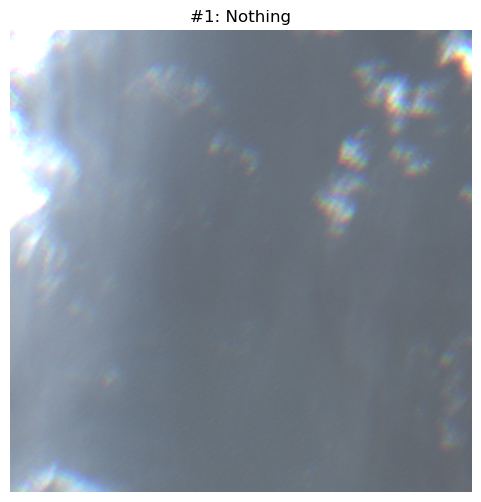

[2] Patch (320, 0) -> Nothing


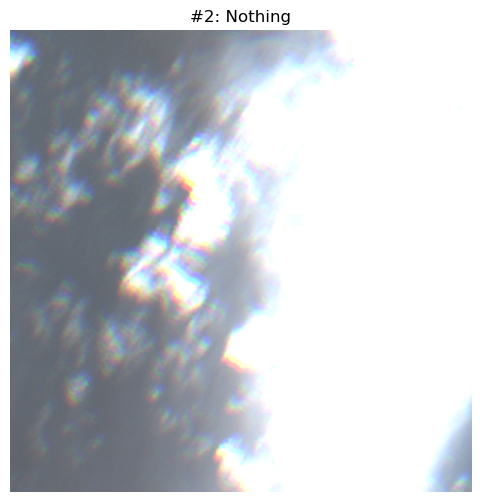

[3] Patch (0, 320) -> Nothing


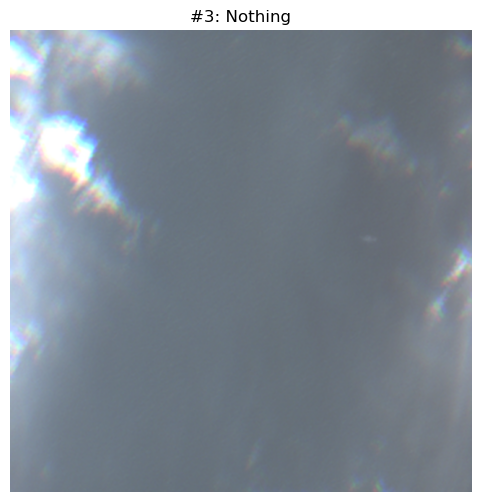

[4] Patch (320, 320) -> Nothing


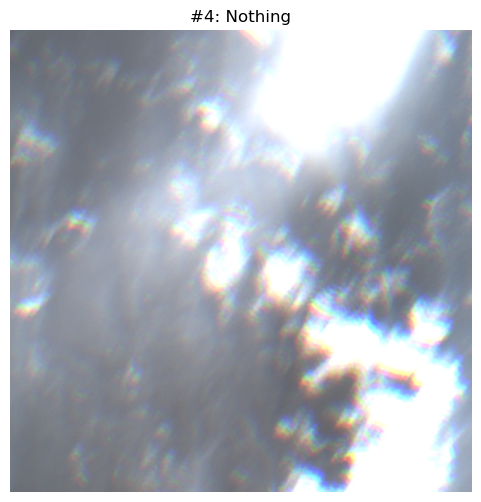

[5] Patch (640, 0) -> Nothing


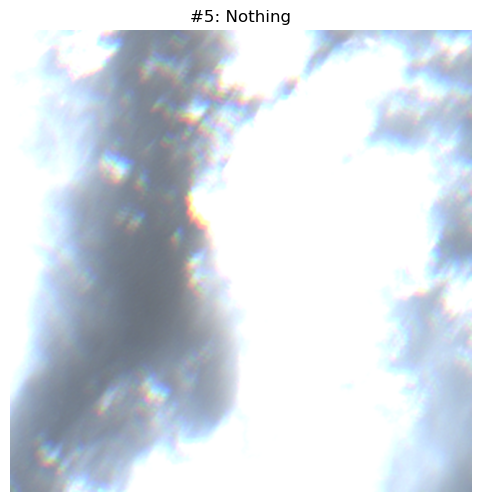

[6] Patch (960, 0) -> ship-S(0.63)


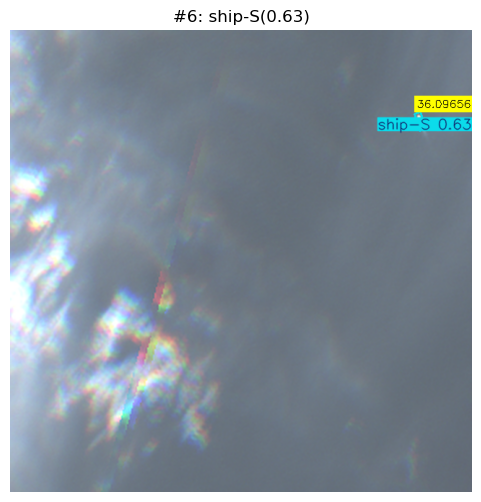

[7] Patch (640, 320) -> ship-S(0.41)


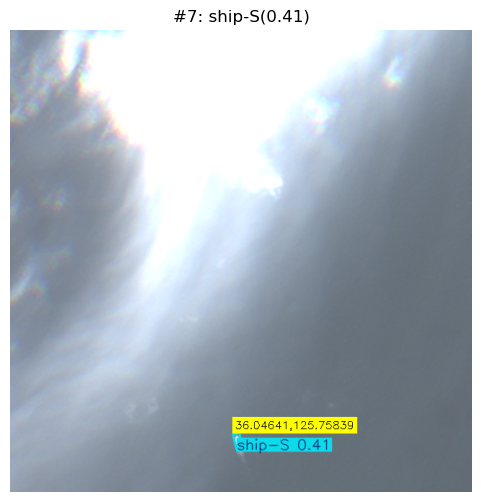

[8] Patch (960, 320) -> ship-S(0.48)


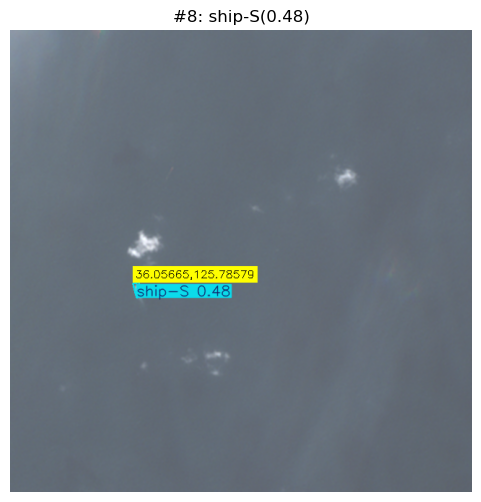

[9] Patch (1280, 0) -> Nothing


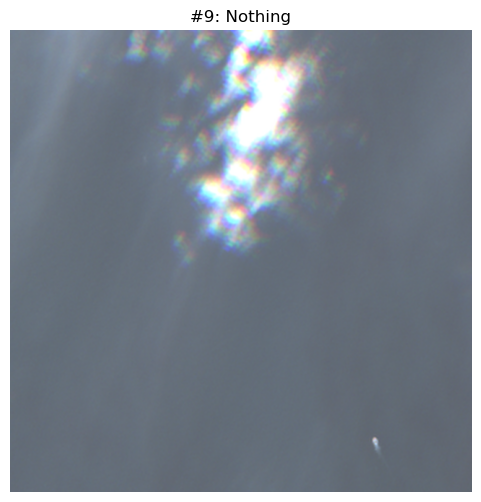

[10] Patch (1600, 0) -> Nothing


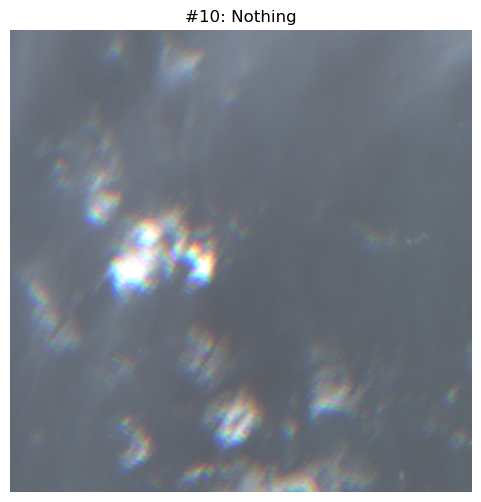

[11] Patch (1280, 320) -> ship-S(0.31)


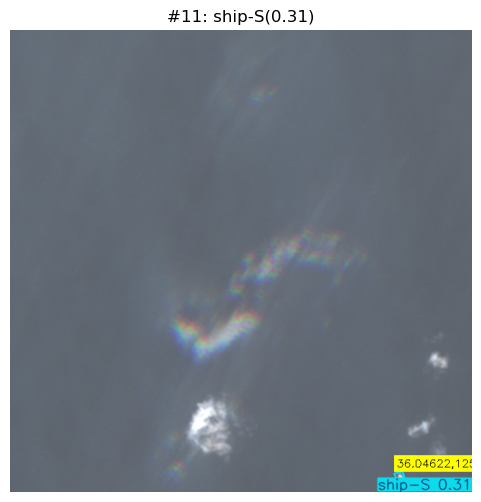

[12] Patch (1600, 320) -> Nothing


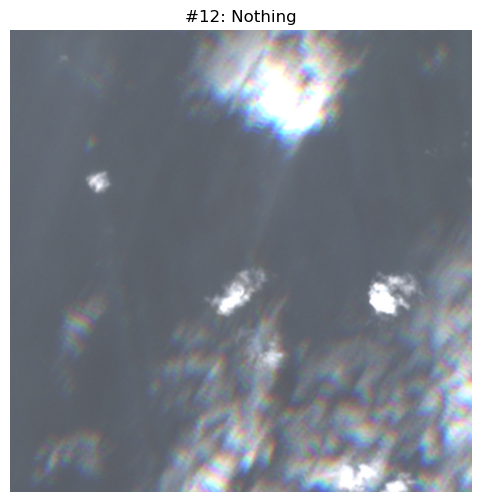

[13] Patch (1920, 0) -> Nothing


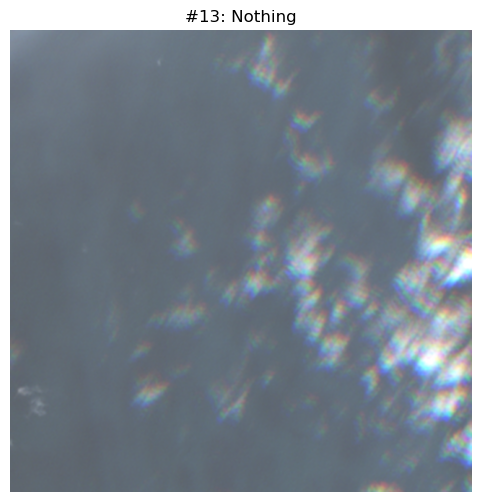

[14] Patch (2240, 0) -> Nothing


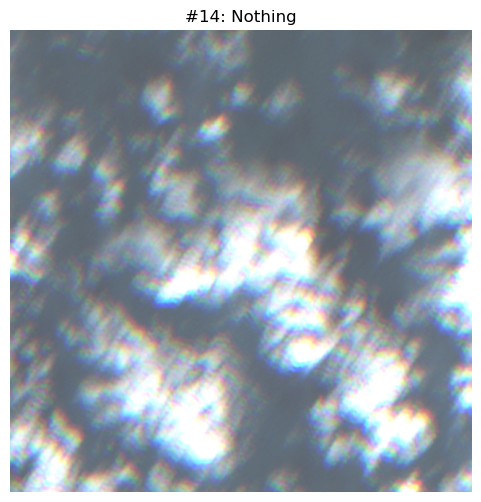

[15] Patch (1920, 320) -> Nothing


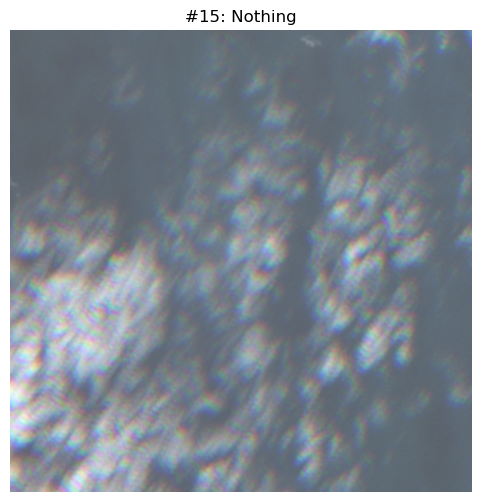

[16] Patch (2240, 320) -> Nothing


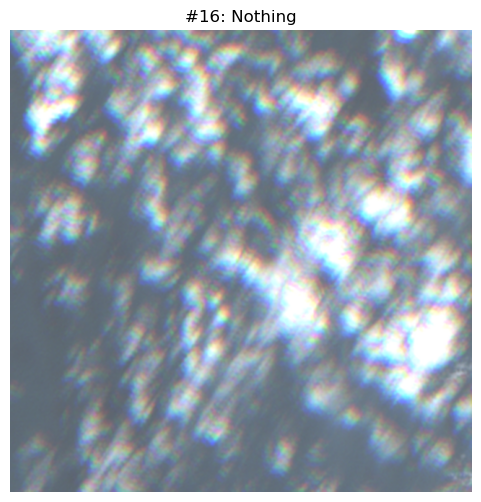

[17] Patch (2560, 0) -> Nothing


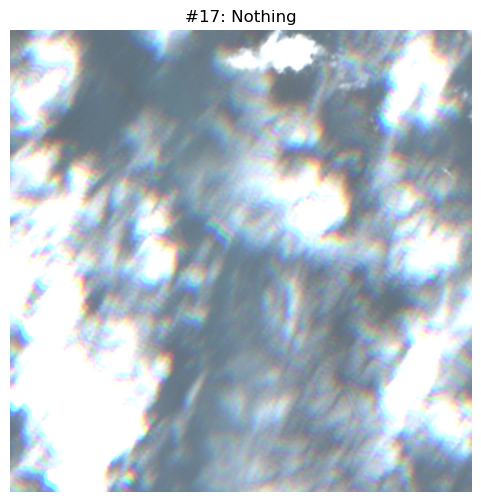

[18] Patch (2880, 0) -> Nothing


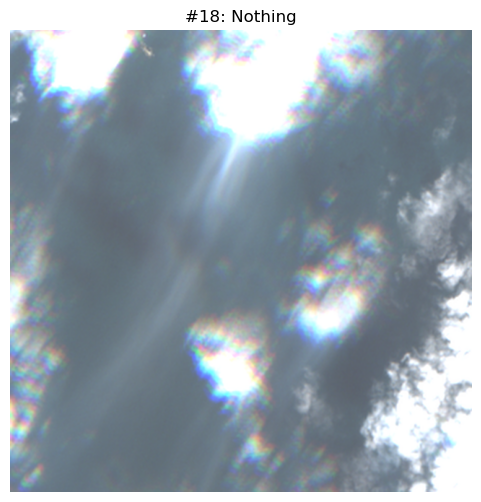

[19] Patch (2560, 320) -> Nothing


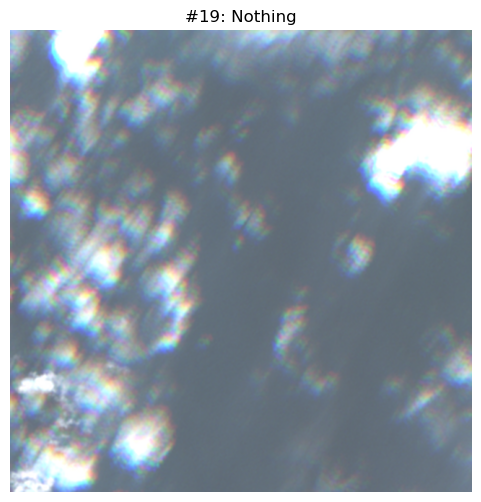

[20] Patch (2880, 320) -> Nothing


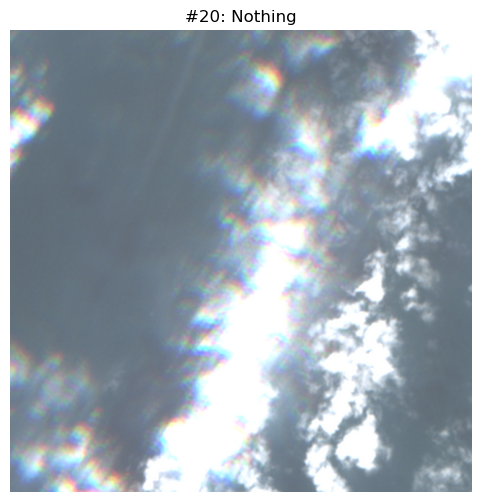

[21] Patch (3200, 0) -> Nothing


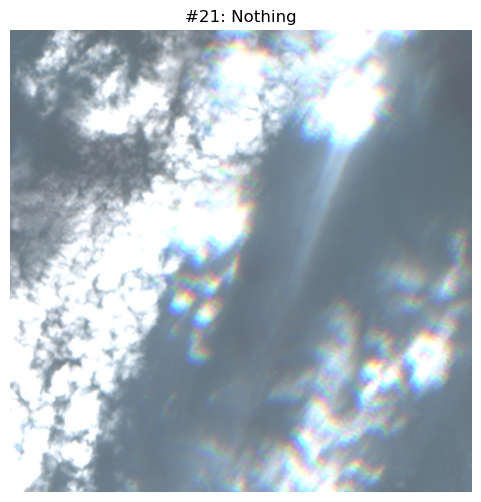

[22] Patch (3520, 0) -> ship-S(0.44)


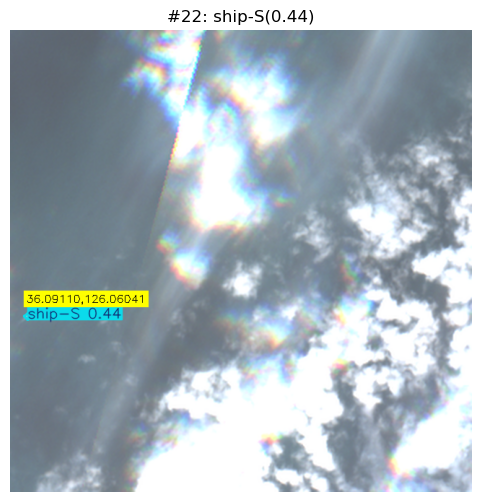

[23] Patch (3200, 320) -> Nothing


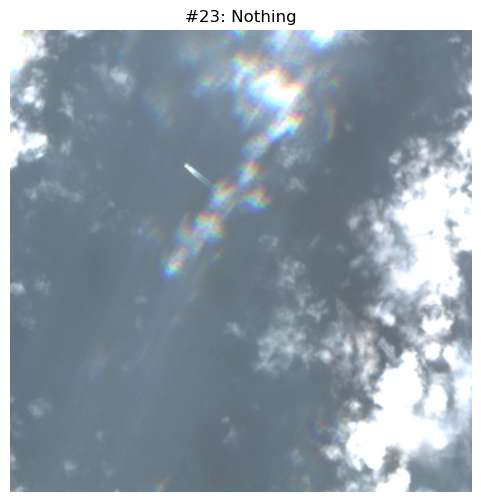

[24] Patch (3520, 320) -> Nothing


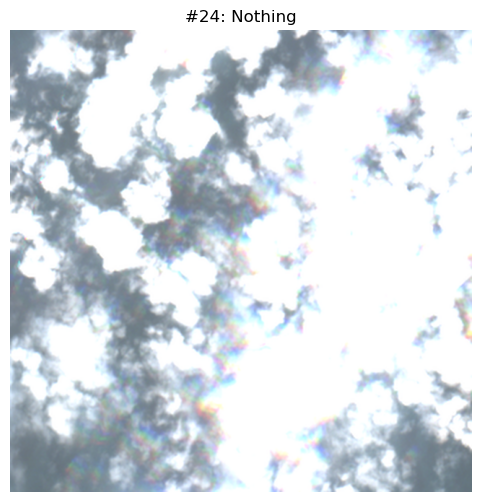

[25] Patch (3840, 0) -> Nothing


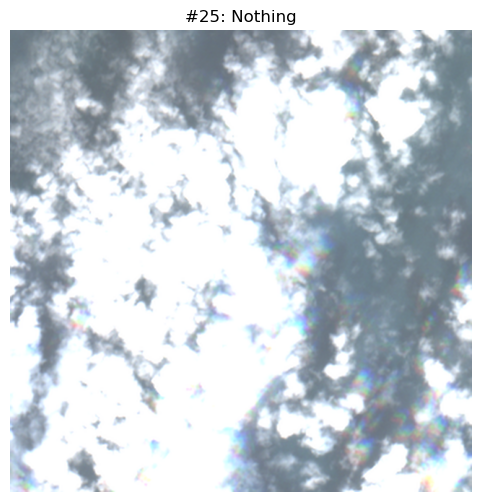

[26] Patch (4160, 0) -> Nothing


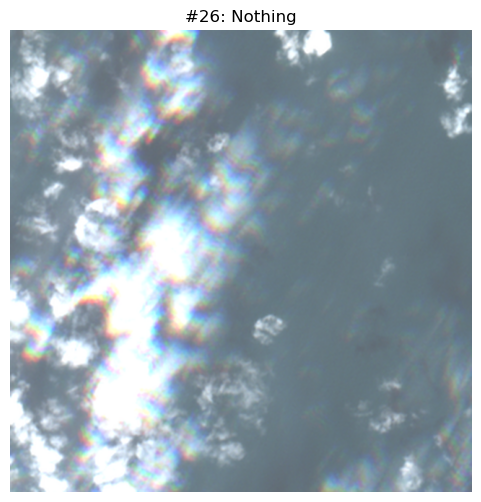

[27] Patch (3840, 320) -> Nothing


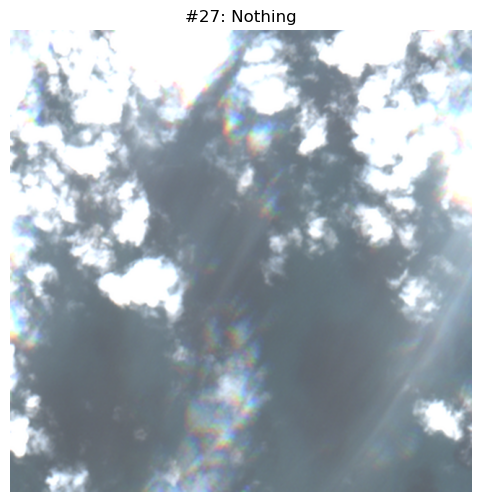

[28] Patch (4160, 320) -> Nothing


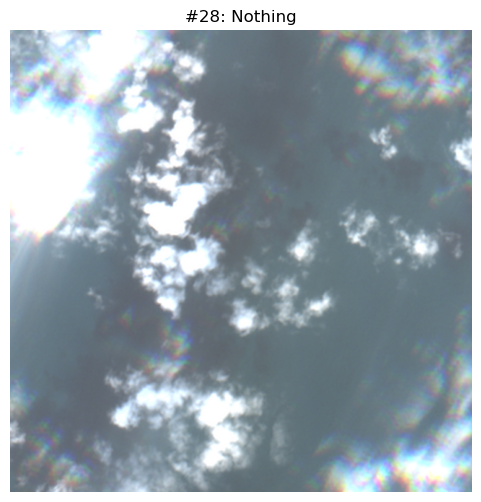

[29] Patch (4480, 0) -> Nothing


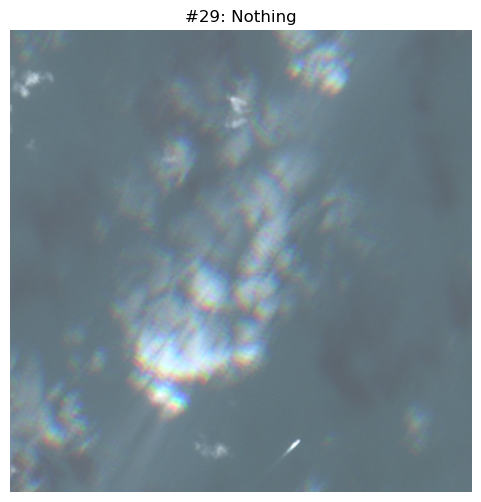

[30] Patch (4800, 0) -> ship-S(0.49)


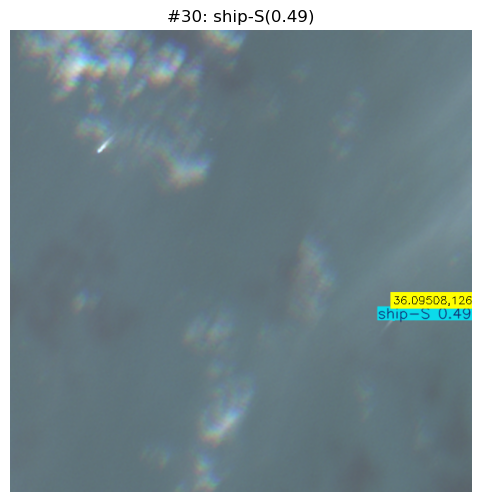

In [8]:
##### RGB 선박 탐지 #####
!pip install ultralytics
import os
import sys
import numpy as np
import rasterio
import rasterio.warp
import cv2
import matplotlib.pyplot as plt
from ultralytics import YOLO

# --- 설정 ---
INPUT_PATH = './input_stack.tif'
MODEL_PATH = './best (2).pt'
MAX_SUB_PATCHES_TO_SHOW = 30
CONF_THRESH = 0.3

# --- 모델 로드 ---
if os.path.exists(MODEL_PATH):
    model = YOLO(MODEL_PATH)
    print("✅ YOLO 모델 로드 성공")
else:
    print(f"❌ 오류: {MODEL_PATH} 파일이 없습니다.")
    sys.exit()

# --- 좌표 변환 ---
def get_lat_lon(global_x, global_y, src):
    try:
        x_crs, y_crs = src.xy(global_y, global_x)
        lon, lat = rasterio.warp.transform(src.crs, {'init': 'epsg:4326'}, [x_crs], [y_crs])
        return lat[0], lon[0]
    except: return 0.0, 0.0

# --- [수정됨] UNet과 동일한 밝기 보정 ---
def convert_16bit_to_8bit_bright(image_16bit):
    """
    통계적 스트레칭 대신, 고정 값(3000)으로 나누어
    전반적인 밝기를 확보합니다. (UNet 시각화 로직과 동일)
    """
    # Sentinel-2 데이터는 보통 0~10000 범위를 가짐
    # 3000으로 나누면 어두운 바다 영역이 밝게 살아남
    image_8bit = np.clip((image_16bit / 3000.0) * 255.0, 0, 255).astype(np.uint8)
    return image_8bit

# --- 만능 데이터 추출기 ---
def get_detections(result):
    detections = []
    # 1. Box
    if result.boxes is not None:
        data = result.boxes.data.cpu().numpy()
        for row in data: detections.append(row[:6])
    # 2. OBB
    elif hasattr(result, 'obb') and result.obb is not None:
        boxes = result.obb.xyxy.cpu().numpy()
        confs = result.obb.conf.cpu().numpy()
        clss = result.obb.cls.cpu().numpy()
        for i in range(len(boxes)):
            detections.append([*boxes[i], confs[i], clss[i]])
    # 3. Mask
    elif hasattr(result, 'masks') and result.masks is not None:
        boxes = result.masks.xyxy.cpu().numpy()
        confs = result.boxes.conf.cpu().numpy()
        clss = result.boxes.cls.cpu().numpy()
        for i in range(len(boxes)):
            detections.append([*boxes[i], confs[i], clss[i]])
    return detections

# --- 메인 실행 ---
def run_yolo_bright():
    if not os.path.exists(INPUT_PATH):
        print("❌ 입력 파일 없음")
        return

    with rasterio.open(INPUT_PATH) as src:
        h, w = src.height, src.width
        base_win_size = 640
        
        x_steps = np.arange(0, w, base_win_size)
        y_steps = np.arange(0, h, base_win_size)
        
        print(f">>> 실시간 탐색 시작 (밝기 보정 적용됨)...")

        shown_count = 0
        
        for y_off in y_steps:
            for x_off in x_steps:
                if shown_count >= MAX_SUB_PATCHES_TO_SHOW:
                    print("\n🛑 출력 제한 도달. 중단합니다.")
                    return

                cw = min(base_win_size, w - x_off)
                ch = min(base_win_size, h - y_off)
                if cw < 64 or ch < 64: continue
                
                # 이미지 읽기 (Band 4,3,2 RGB)
                try:
                    img_bands = src.read([4, 3, 2], window=rasterio.windows.Window(x_off, y_off, cw, ch))
                    img_16bit = img_bands.transpose(1, 2, 0).astype(np.float32)
                    
                    # [여기서 밝기 함수 변경]
                    img_8bit = convert_16bit_to_8bit_bright(img_16bit)
                except: continue
                
                # 4분할
                sub_win_size = base_win_size // 2
                sub_patches_info = [
                    (img_8bit[0:sub_win_size, 0:sub_win_size], (0, 0)),
                    (img_8bit[0:sub_win_size, sub_win_size:base_win_size], (sub_win_size, 0)),
                    (img_8bit[sub_win_size:base_win_size, 0:sub_win_size], (0, sub_win_size)),
                    (img_8bit[sub_win_size:base_win_size, sub_win_size:base_win_size], (sub_win_size, sub_win_size))
                ]

                for i, (sub_patch, (sub_x, sub_y)) in enumerate(sub_patches_info):
                    if sub_patch.shape[0] < 32 or sub_patch.shape[1] < 32: continue
                    if shown_count >= MAX_SUB_PATCHES_TO_SHOW: return

                    shown_count += 1
                    
                    # 1. 확대
                    zoomed_patch = cv2.resize(sub_patch, (base_win_size, base_win_size), interpolation=cv2.INTER_LANCZOS4)
                    img_bgr = cv2.cvtColor(zoomed_patch, cv2.COLOR_RGB2BGR)
                    
                    # 2. 추론
                    results = model(img_bgr, conf=CONF_THRESH, verbose=False)
                    result = results[0]
                    detections = get_detections(result)
                    
                    # 시각화 베이스
                    res_plot_bgr = result.plot()
                    res_plot_rgb = cv2.cvtColor(res_plot_bgr, cv2.COLOR_BGR2RGB)
                    
                    box_count = len(detections)
                    found_any = False
                    msg_items = []
                    
                    # 4. 좌표 그리기
                    if box_count > 0:
                        found_any = True
                        for row in detections:
                            x1, y1, x2, y2, conf, cls_id = row
                            
                            c_name = model.names[int(cls_id)] if model.names else str(int(cls_id))
                            msg_items.append(f"{c_name}({conf:.2f})")
                            
                            # 좌표 계산
                            cx_orig = ((x1 + x2) / 2) / 2
                            cy_orig = ((y1 + y2) / 2) / 2
                            
                            global_x = x_off + sub_x + cx_orig
                            global_y = y_off + sub_y + cy_orig
                            
                            lat, lon = get_lat_lon(global_x, global_y, src)
                            
                            # 텍스트
                            coord_txt = f"{lat:.5f},{lon:.5f}"
                            bx1, by1 = int(x1), int(y1) - 22
                            (tw, th), _ = cv2.getTextSize(coord_txt, cv2.FONT_HERSHEY_SIMPLEX, 0.5, 1)
                            bx2, by2 = int(x1) + tw + 6, int(y1)
                            
                            if by1 < 0: by1, by2 = int(y1), int(y1) + 22
                            
                            cv2.rectangle(res_plot_rgb, (bx1, by1), (bx2, by2), (255, 255, 0), -1)
                            cv2.putText(res_plot_rgb, coord_txt, (bx1 + 3, by2 - 6), 
                                        cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 0), 1)

                    detection_msg = ", ".join(msg_items) if found_any else "Nothing"
                    
                    print(f"[{shown_count}] Patch ({x_off+sub_x}, {y_off+sub_y}) -> {detection_msg}")
                    
                    plt.figure(figsize=(6, 6))
                    plt.imshow(res_plot_rgb)
                    plt.title(f"#{shown_count}: {detection_msg}")
                    plt.axis('off')
                    plt.show()

run_yolo_bright()

✅ 해양 쓰레기(Marine Debris) 모델 로드 성공
>>> 해양 쓰레기 실시간 탐색 시작 (모델: ./best (3).pt)...
[1] Debris Scan (0, 0) -> Marine Debris


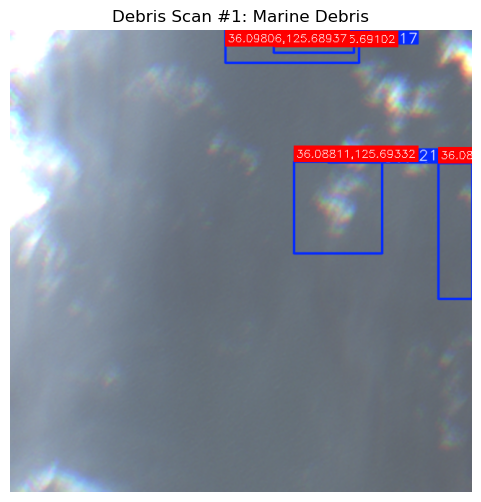

[2] Debris Scan (320, 0) -> Marine Debris


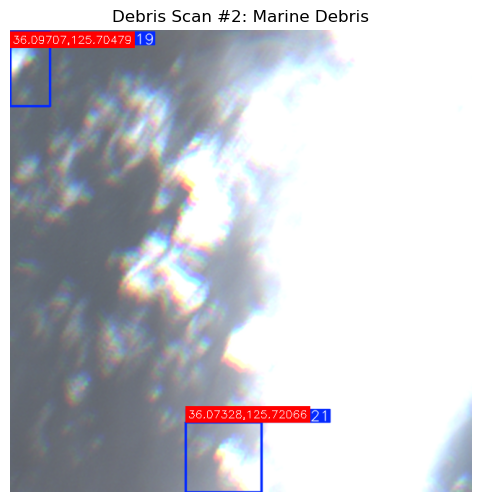

[3] Debris Scan (0, 320) -> Marine Debris


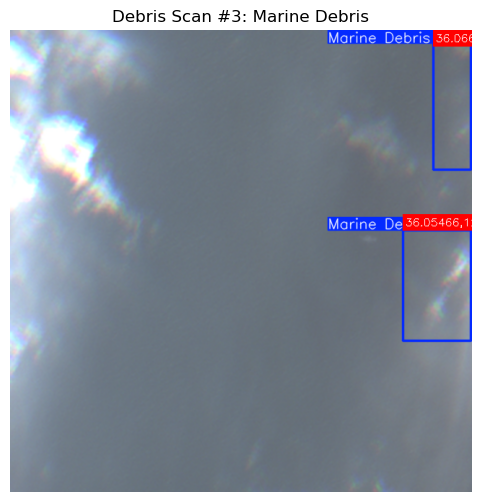

[4] Debris Scan (320, 320) -> Marine Debris


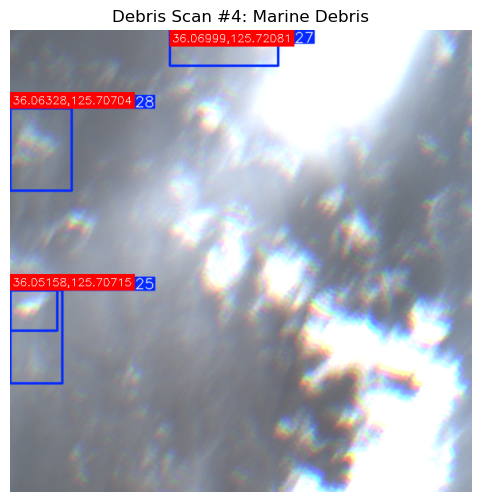

[5] Debris Scan (640, 0) -> Marine Debris


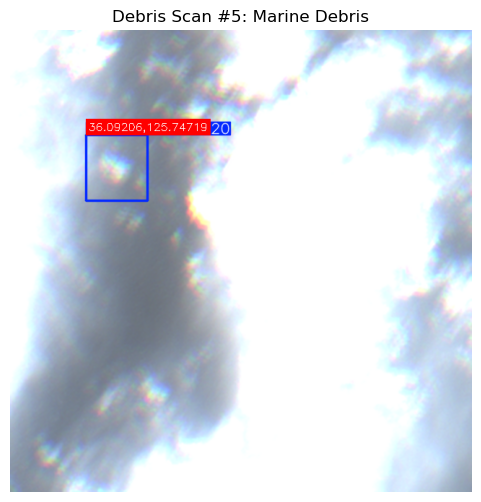

[6] Debris Scan (960, 0) -> Marine Debris


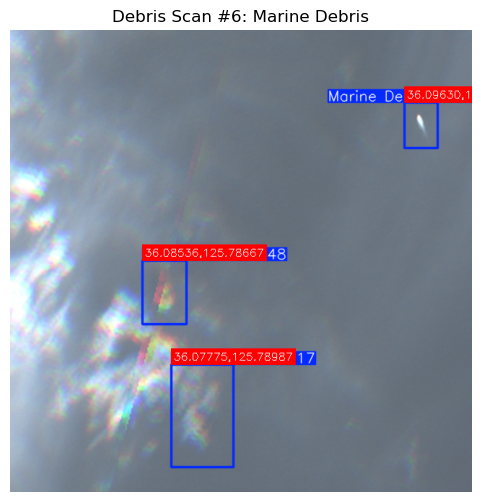

[7] Debris Scan (640, 320) -> Marine Debris


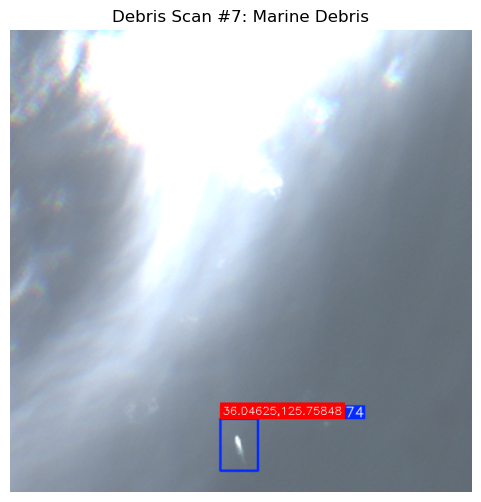

[8] Debris Scan (960, 320) -> Marine Debris


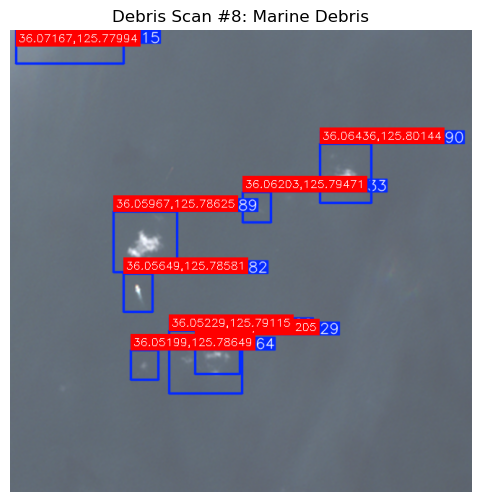

[9] Debris Scan (1280, 0) -> Marine Debris


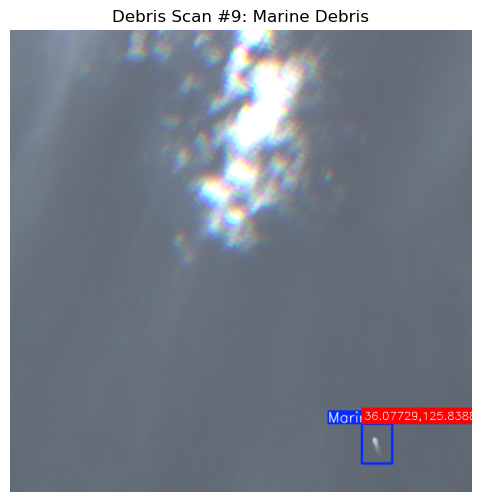

[10] Debris Scan (1600, 0) -> Marine Debris


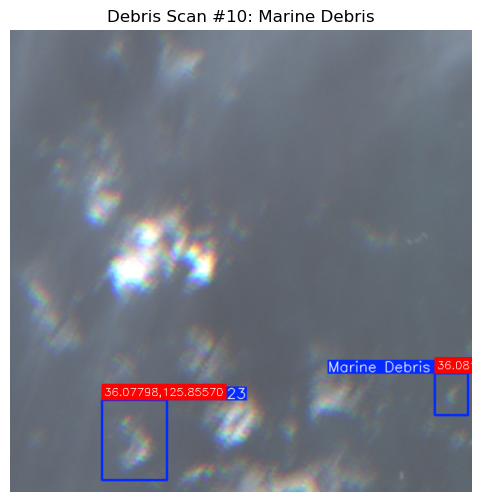

[11] Debris Scan (1280, 320) -> Marine Debris


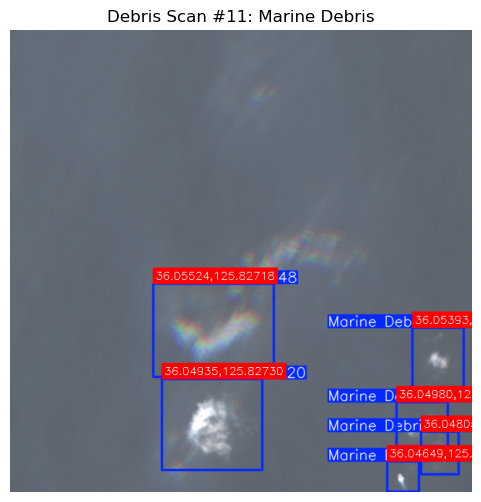

[12] Debris Scan (1600, 320) -> Marine Debris


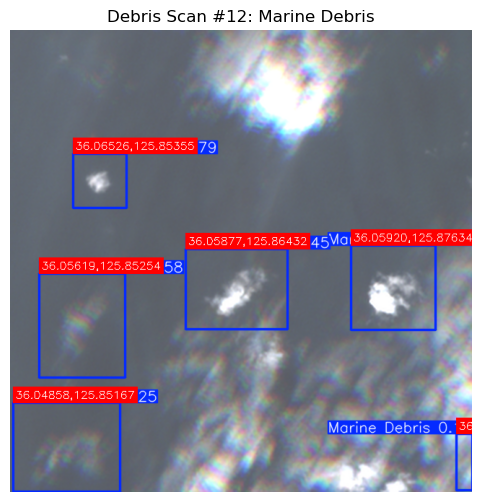

[13] Debris Scan (1920, 0) -> Marine Debris


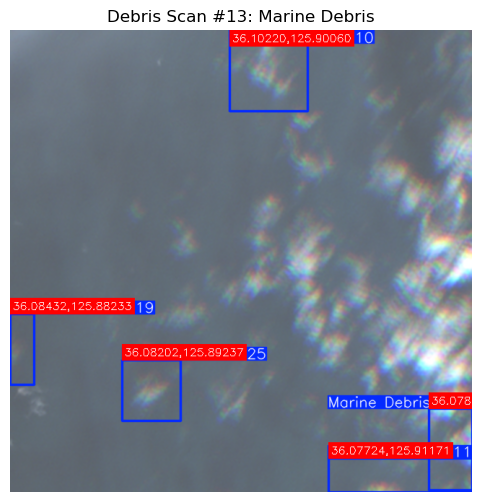

[14] Debris Scan (2240, 0) -> Marine Debris


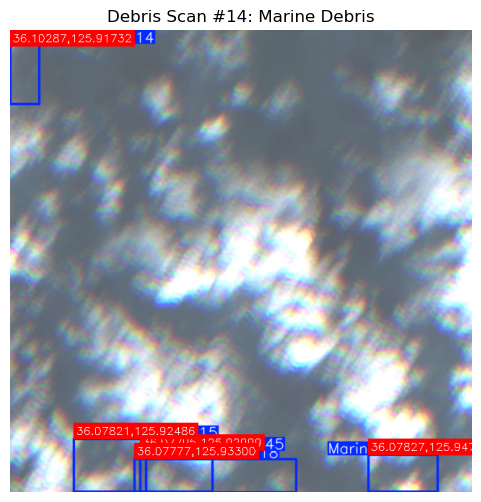

[15] Debris Scan (1920, 320) -> Marine Debris


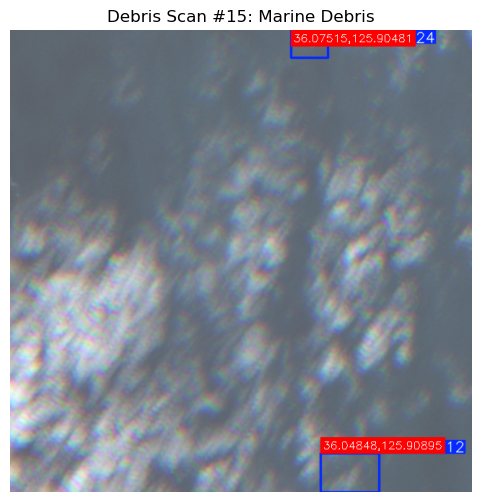

[16] Debris Scan (2240, 320) -> Marine Debris


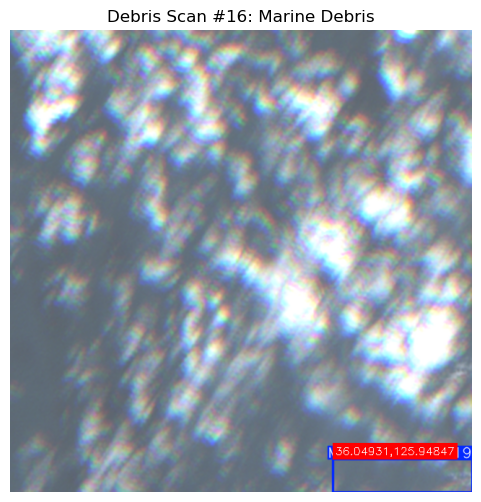

[17] Debris Scan (2560, 0) -> Marine Debris


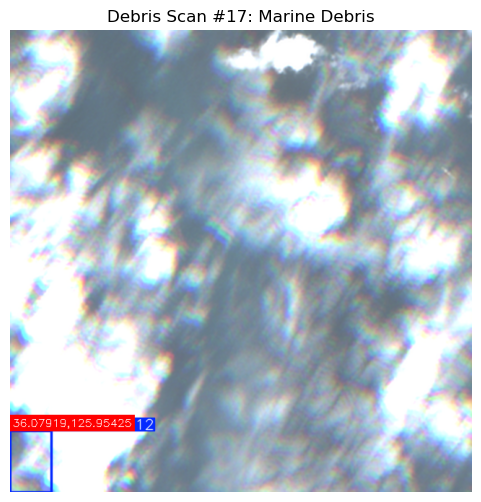

[18] Debris Scan (2880, 0) -> Marine Debris


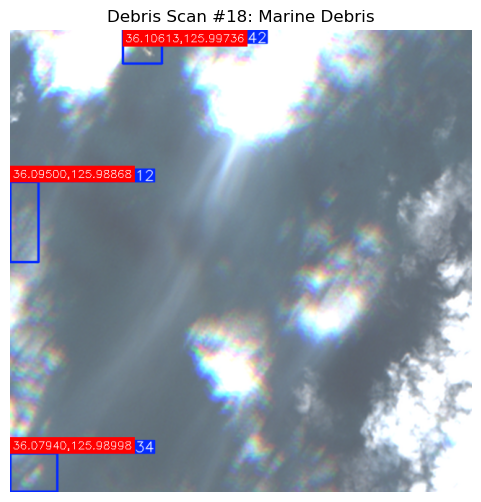

[19] Debris Scan (2560, 320) -> Marine Debris


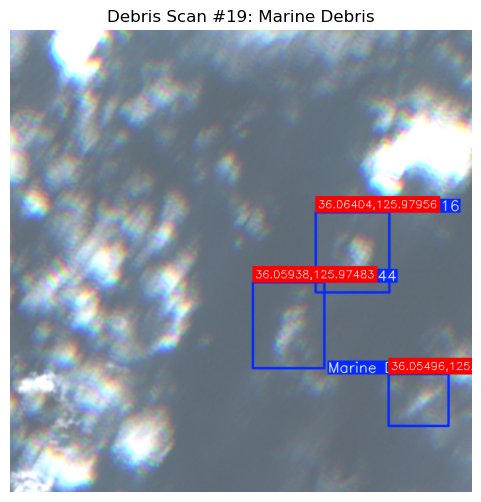

[20] Debris Scan (2880, 320) -> Marine Debris


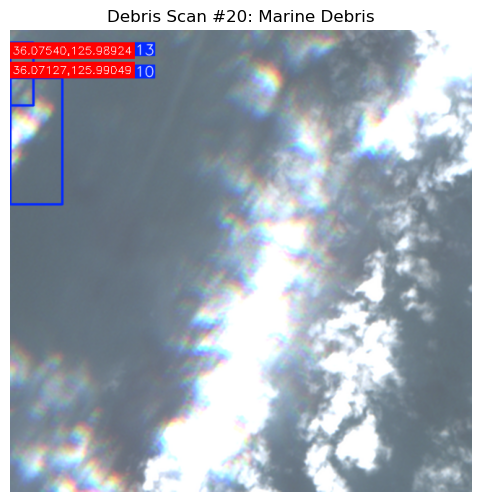


🛑 출력 제한 도달. 중단합니다.


In [9]:
##### RGB 쓰레기 #######
import os
import sys
import numpy as np
import rasterio
import rasterio.warp
import cv2
import matplotlib.pyplot as plt
from ultralytics import YOLO

# --- 설정 ---
INPUT_PATH = './input_stack.tif'
MODEL_PATH = './best (3).pt'  # 해양 쓰레기 모델
MAX_SUB_PATCHES_TO_SHOW = 20
CONF_THRESH = 0.1             # 쓰레기는 작으므로 감도를 예민하게 설정

# --- 모델 로드 ---
if os.path.exists(MODEL_PATH):
    model = YOLO(MODEL_PATH)
    print("✅ 해양 쓰레기(Marine Debris) 모델 로드 성공")
else:
    print(f"❌ 오류: {MODEL_PATH} 파일이 없습니다.")
    sys.exit()

# --- 좌표 변환 ---
def get_lat_lon(global_x, global_y, src):
    try:
        x_crs, y_crs = src.xy(global_y, global_x)
        lon, lat = rasterio.warp.transform(src.crs, {'init': 'epsg:4326'}, [x_crs], [y_crs])
        return lat[0], lon[0]
    except: return 0.0, 0.0

# --- 밝기 보정 (필수) ---
def convert_16bit_to_8bit_bright(image_16bit):
    # 쓰레기 식별을 위해 이미지를 밝게 만듭니다.
    image_8bit = np.clip((image_16bit / 3000.0) * 255.0, 0, 255).astype(np.uint8)
    return image_8bit

# --- 데이터 추출 ---
def get_detections(result):
    detections = []
    if result.boxes is not None:
        data = result.boxes.data.cpu().numpy()
        for row in data: detections.append(row[:6])
    elif hasattr(result, 'obb') and result.obb is not None:
        boxes = result.obb.xyxy.cpu().numpy()
        confs = result.obb.conf.cpu().numpy()
        clss = result.obb.cls.cpu().numpy()
        for i in range(len(boxes)): detections.append([*boxes[i], confs[i], clss[i]])
    return detections

# --- 메인 실행 ---
def run_debris_scan():
    if not os.path.exists(INPUT_PATH):
        print("❌ 입력 파일 없음")
        return

    with rasterio.open(INPUT_PATH) as src:
        h, w = src.height, src.width
        base_win_size = 640
        
        # 스캔 범위 설정
        x_steps = np.arange(0, w, base_win_size)
        y_steps = np.arange(0, h, base_win_size)
        
        print(f">>> 해양 쓰레기 실시간 탐색 시작 (모델: {MODEL_PATH})...")

        shown_count = 0
        
        for y_off in y_steps:
            for x_off in x_steps:
                if shown_count >= MAX_SUB_PATCHES_TO_SHOW:
                    print("\n🛑 출력 제한 도달. 중단합니다.")
                    return

                cw = min(base_win_size, w - x_off)
                ch = min(base_win_size, h - y_off)
                if cw < 64 or ch < 64: continue
                
                # 이미지 읽기 (RGB Bands 4,3,2)
                try:
                    img_bands = src.read([4, 3, 2], window=rasterio.windows.Window(x_off, y_off, cw, ch))
                    img_16bit = img_bands.transpose(1, 2, 0).astype(np.float32)
                    img_8bit = convert_16bit_to_8bit_bright(img_16bit)
                except: continue
                
                # 정밀 탐색을 위해 4분할 (쓰레기는 작아서 확대 필수)
                sub_win_size = base_win_size // 2
                sub_patches_info = [
                    (img_8bit[0:sub_win_size, 0:sub_win_size], (0, 0)),
                    (img_8bit[0:sub_win_size, sub_win_size:base_win_size], (sub_win_size, 0)),
                    (img_8bit[sub_win_size:base_win_size, 0:sub_win_size], (0, sub_win_size)),
                    (img_8bit[sub_win_size:base_win_size, sub_win_size:base_win_size], (sub_win_size, sub_win_size))
                ]

                for i, (sub_patch, (sub_x, sub_y)) in enumerate(sub_patches_info):
                    if sub_patch.shape[0] < 32 or sub_patch.shape[1] < 32: continue
                    if shown_count >= MAX_SUB_PATCHES_TO_SHOW: return

                    shown_count += 1
                    
                    # 확대 (Zoom)
                    zoomed_patch = cv2.resize(sub_patch, (base_win_size, base_win_size), interpolation=cv2.INTER_LANCZOS4)
                    img_bgr = cv2.cvtColor(zoomed_patch, cv2.COLOR_RGB2BGR)
                    
                    # 추론
                    results = model(img_bgr, conf=CONF_THRESH, verbose=False)
                    result = results[0]
                    detections = get_detections(result)
                    
                    # 시각화 준비
                    res_plot_bgr = result.plot()
                    res_plot_rgb = cv2.cvtColor(res_plot_bgr, cv2.COLOR_BGR2RGB)
                    
                    box_count = len(detections)
                    found_any = False
                    msg_items = []
                    
                    if box_count > 0:
                        found_any = True
                        for row in detections:
                            x1, y1, x2, y2, conf, cls_id = row
                            
                            c_name = model.names[int(cls_id)] if model.names else "Debris"
                            msg_items.append(f"{c_name}")
                            
                            # 좌표 변환 (확대된 픽셀 -> 원본 위경도)
                            cx_orig = ((x1 + x2) / 2) / 2
                            cy_orig = ((y1 + y2) / 2) / 2
                            
                            global_x = x_off + sub_x + cx_orig
                            global_y = y_off + sub_y + cy_orig
                            
                            lat, lon = get_lat_lon(global_x, global_y, src)
                            
                            # 좌표 그리기
                            coord_txt = f"{lat:.5f},{lon:.5f}"
                            bx1, by1 = int(x1), int(y1) - 22
                            (tw, th), _ = cv2.getTextSize(coord_txt, cv2.FONT_HERSHEY_SIMPLEX, 0.5, 1)
                            bx2, by2 = int(x1) + tw + 6, int(y1)
                            
                            if by1 < 0: by1, by2 = int(y1), int(y1) + 22
                            
                            cv2.rectangle(res_plot_rgb, (bx1, by1), (bx2, by2), (255, 0, 0), -1) # 빨간 박스
                            cv2.putText(res_plot_rgb, coord_txt, (bx1 + 3, by2 - 6), 
                                        cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 1)

                    detection_msg = ", ".join(list(set(msg_items))) if found_any else "Nothing"
                    
                    print(f"[{shown_count}] Debris Scan ({x_off+sub_x}, {y_off+sub_y}) -> {detection_msg}")
                    
                    plt.figure(figsize=(6, 6))
                    plt.imshow(res_plot_rgb)
                    plt.title(f"Debris Scan #{shown_count}: {detection_msg}")
                    plt.axis('off')
                    plt.show()

run_debris_scan()

In [10]:
import boto3

# AWS SageMaker 클라이언트 연결
sm_client = boto3.client('sagemaker')

# 현재 'InService' (돌아가고 있는) 엔드포인트 조회
response = sm_client.list_endpoints(StatusEquals='InService')
endpoints = response.get('Endpoints', [])

print(f"💸 현재 과금 중인 엔드포인트 개수: {len(endpoints)}개")

if len(endpoints) > 0:
    print("⚠️ 주의! 아래 엔드포인트가 돌아가고 있습니다. 삭제가 필요합니다:")
    for ep in endpoints:
        print(f" - {ep['EndpointName']}")
else:
    print("✅ 안심하세요. 돌아가고 있는 엔드포인트가 없습니다.")

💸 현재 과금 중인 엔드포인트 개수: 0개
✅ 안심하세요. 돌아가고 있는 엔드포인트가 없습니다.
